<a href="https://colab.research.google.com/github/satish-1999/Fake_News_D/blob/main/FAKE_1st_text%2Btitle_LSTM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# import key libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud, STOPWORDS
import nltk
import re
from nltk.stem import PorterStemmer, WordNetLemmatizer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize, sent_tokenize
import gensim
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS
import plotly.express as px

# Tensorflow
import tensorflow as tf
from tensorflow.keras.preprocessing.text import one_hot,Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, Embedding, Input, LSTM, Conv1D, MaxPool1D, Bidirectional, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical

In [ ]:
# Mount the google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# install nltk
# NLTK: Natural Language tool kit
!pip install nltk

In [ ]:
# install gensim
# Gensim is an open-source library for unsupervised topic modeling and natural language processing
# Gensim is implemented in Python and Cython.
!pip install gensim

In [ ]:
# load the stock news data
data = pd.read_csv("/content/drive/MyDrive/FAKE NEWS/train.csv")
data.drop('author',axis=1)

,id,title,text,label
0,0,House Dem Aide: We Didn’t Even See Comey’s Let...,House Dem Aide: We Didn’t Even See Comey’s Let...,1
1,1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Ever get the feeling your life circles the rou...,0
2,2,Why the Truth Might Get You Fired,"Why the Truth Might Get You Fired October 29, ...",1
3,3,15 Civilians Killed In Single US Airstrike Hav...,Videos 15 Civilians Killed In Single US Airstr...,1
4,4,Iranian woman jailed for fictional unpublished...,Print \nAn Iranian woman has been sentenced to...,1
...,...,...,...,...
20795,20795,Rapper T.I.: Trump a ’Poster Child For White S...,Rapper T. I. unloaded on black celebrities who...,0
20796,20796,"N.F.L. Playoffs: Schedule, Matchups and Odds -...",When the Green Bay Packers lost to the Washing...,0
20797,20797,Macy’s Is Said to Receive Takeover Approach by...,The Macy’s of today grew from the union of sev...,0
20798,20798,"NATO, Russia To Hold Parallel Exercises In Bal...","NATO, Russia To Hold Parallel Exercises In Bal...",1


In [ ]:
# Let's view the dataset 
data

,id,title,author,text,label
0,0,House Dem Aide: We Didn’t Even See Comey’s Let...,Darrell Lucus,House Dem Aide: We Didn’t Even See Comey’s Let...,1
1,1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Daniel J. Flynn,Ever get the feeling your life circles the rou...,0
2,2,Why the Truth Might Get You Fired,Consortiumnews.com,"Why the Truth Might Get You Fired October 29, ...",1
3,3,15 Civilians Killed In Single US Airstrike Hav...,Jessica Purkiss,Videos 15 Civilians Killed In Single US Airstr...,1
4,4,Iranian woman jailed for fictional unpublished...,Howard Portnoy,Print \nAn Iranian woman has been sentenced to...,1
...,...,...,...,...,...
20795,20795,Rapper T.I.: Trump a ’Poster Child For White S...,Jerome Hudson,Rapper T. I. unloaded on black celebrities who...,0
20796,20796,"N.F.L. Playoffs: Schedule, Matchups and Odds -...",Benjamin Hoffman,When the Green Bay Packers lost to the Washing...,0
20797,20797,Macy’s Is Said to Receive Takeover Approach by...,Michael J. de la Merced and Rachel Abrams,The Macy’s of today grew from the union of sev...,0
20798,20798,"NATO, Russia To Hold Parallel Exercises In Bal...",Alex Ansary,"NATO, Russia To Hold Parallel Exercises In Bal...",1


In [ ]:
data['news']=data['text']+" "+ data['title']

In [ ]:
# dataframe information
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20800 entries, 0 to 20799
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      20800 non-null  int64 
 1   title   20242 non-null  object
 2   author  18843 non-null  object
 3   text    20761 non-null  object
 4   label   20800 non-null  int64 
 5   news    20203 non-null  object
dtypes: int64(2), object(4)
memory usage: 975.1+ KB


In [ ]:
import string
string.punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [ ]:
data['text'][2]

'Why the Truth Might Get You Fired October 29, 2016 \nThe tension between intelligence analysts and political policymakers has always been between honest assessments and desired results, with the latter often overwhelming the former, as in the Iraq War, writes Lawrence Davidson. \nBy Lawrence Davidson \nFor those who might wonder why foreign policy makers repeatedly make bad choices, some insight might be drawn from the following analysis. The action here plays out in the United States, but the lessons are probably universal. \nBack in the early spring of 2003, George W. Bush initiated the invasion of Iraq. One of his key public reasons for doing so was the claim that the country’s dictator, Saddam Hussein, was on the verge of developing nuclear weapons and was hiding other weapons of mass destruction. The real reason went beyond that charge and included a long-range plan for “regime change” in the Middle East. President George W. Bush and Vice President Dick Cheney receive an Oval Off

In [ ]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
import re
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
corpus = []
for i in range(0,20800):
  review = re.sub('[^a-zA-Z]', ' ', str(data['news'][i]))
  review = review.lower()
  review = review.split()
  ps = PorterStemmer()
  all_stopwords = stopwords.words('english')
  all_stopwords.remove('not')
  review = [ps.stem(word) for word in review if not word in set(all_stopwords)]
  review = ' '.join(review)
  corpus.append(review)

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
# word_tokenize is used to break up a string into words
print(corpus[0])
print(nltk.word_tokenize(corpus[0]))

hous dem aid even see comey letter jason chaffetz tweet darrel lucu octob subscrib jason chaffetz stump american fork utah imag courtesi michael jolley avail creativ common licens apolog keith olbermann doubt worst person world week fbi director jame comey accord hous democrat aid look like also know second worst person well turn comey sent infam letter announc fbi look email may relat hillari clinton email server rank democrat relev committe hear comey found via tweet one republican committe chairmen know comey notifi republican chairmen democrat rank member hous intellig judiciari oversight committe agenc review email recent discov order see contain classifi inform not long letter went oversight committe chairman jason chaffetz set polit world ablaz tweet fbi dir inform fbi learn exist email appear pertin investig case reopen jason chaffetz jasoninthehous octob cours know not case comey actual say review email light unrel case know anthoni weiner sext teenag appar littl thing fact ma

In [ ]:
# Obtain the maximum length of data in the document
# This will be later used when word embeddings are generated
maxlen = -1
for doc in corpus:
    tokens = nltk.word_tokenize(doc)
    if(maxlen < len(tokens)):
        maxlen = len(tokens)
print("The maximum number of words in any document is:", maxlen)

The maximum number of words in any document is: 12253


In [ ]:
tweets_length = [ len(nltk.word_tokenize(x)) for x in corpus ]
tweets_length

[446,
 378,
 707,
 314,
 96,
 122,
 290,
 478,
 715,
 1025,
 879,
 303,
 276,
 151,
 3054,
 584,
 718,
 261,
 789,
 170,
 225,
 185,
 97,
 266,
 456,
 429,
 276,
 244,
 439,
 3475,
 278,
 682,
 693,
 921,
 635,
 958,
 1965,
 1744,
 239,
 494,
 303,
 427,
 327,
 109,
 256,
 578,
 319,
 6,
 234,
 224,
 540,
 314,
 200,
 1,
 38,
 472,
 143,
 818,
 844,
 999,
 680,
 36,
 712,
 252,
 387,
 358,
 916,
 198,
 180,
 112,
 714,
 3008,
 204,
 847,
 759,
 471,
 245,
 149,
 676,
 120,
 481,
 30,
 4,
 164,
 1104,
 147,
 19,
 706,
 184,
 457,
 542,
 306,
 714,
 521,
 119,
 450,
 644,
 163,
 772,
 722,
 22,
 558,
 500,
 306,
 207,
 288,
 330,
 103,
 233,
 386,
 813,
 155,
 116,
 635,
 831,
 269,
 455,
 553,
 547,
 823,
 1,
 448,
 489,
 680,
 1,
 46,
 1561,
 818,
 397,
 334,
 70,
 82,
 976,
 665,
 272,
 359,
 184,
 504,
 232,
 270,
 1,
 222,
 1,
 367,
 272,
 199,
 648,
 209,
 55,
 397,
 81,
 206,
 275,
 672,
 735,
 630,
 720,
 809,
 201,
 2434,
 749,
 452,
 25,
 31,
 138,
 427,
 584,
 530,
 115,
 10,


In [ ]:
tweets_length[0]

446

In [ ]:
total_words=0
for x in tweets_length:
  total_words = total_words + tweets_length[x]
print(total_words)

9667731


In [ ]:
# Plot the distribution for the number of words in a text
fig = px.histogram(x = tweets_length, nbins = 100)
fig.show()

In [ ]:
# split the data into test and train 
X = corpus


In [ ]:
y=data['label']

In [ ]:
set(y)

{0, 1}

In [ ]:
len(y)

20800

In [ ]:
y

0        1
1        0
2        1
3        1
4        1
        ..
20795    0
20796    0
20797    0
20798    1
20799    1
Name: label, Length: 20800, dtype: int64

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.1)

In [ ]:
len(X_train)

18720

In [ ]:
len(X_test)

2080

In [ ]:
X_train

['jake gyllenha delay return broadway reviv lanford wilson burn star mr gyllenha schedul begin perform februari hudson theater instead postpon produc stacey mindich jessica r jenen said brief statement friday even said postpon due schedul conflict show star show aim broadway bow season mr gyllenha primarili known work film appear broadway constel play nick payn ran three month ambassador theater group reconvert hudson hotel event space theater said plan announc anoth product soon mr gyllenha fan howev anoth opportun see onstag new york next week schedul star four concert perform sunday park georg new york citi center jake gyllenha return broadway not fast new york time',
 'dalla mississippi state list start point guard morgan william feet inch matter generos accuraci need coach vic schaefer said amusedli pretti sure second part matter william shortest player court made biggest play nation semifin late friday jump shot buzzer overtim defeat connecticut epic upset halt huski win streak e

In [ ]:
X_test

['link simpl fact not cold war mark ii far russia declin economi noth like soviet union aspir establish differ world order pursu capitalist west russia mani way weak countri leadership strong sens encircl view west eager rightli wrongli drive mr putin assert approach sourc articl link chill piec read yet concern current tension russia fact publish bbc help articl put rest lot counter argument recent ww thread not good news situat clearli wors told edit profus reason given bbc nato send messag russia',
 'report copyright violat call ohio voter diebolt call elect board morn summit counti talk man assur basic voter fraud go happen howev mention west south might risk use diebolt vote machin anyon ohio pleas call elect board ask voter fraud think need boot ground diebolt vote machin use call ohio voter diebolt',
 'citi san francisco demand statist detail compani uber lyft assess impact traffic congest safeti pollut park ascertain whether access disabl rider citi attorney denni herrera monda

In [ ]:
# Create a tokenizer to tokenize the words and create sequences of tokenized words
tokenizer = Tokenizer(num_words = total_words)
tokenizer.fit_on_texts(X)#X_train   tha 

# Training data
train_sequences = tokenizer.texts_to_sequences(X_train)

# Testing data
test_sequences = tokenizer.texts_to_sequences(X_test)


In [ ]:
train_sequences

[[4665,
  17601,
  1745,
  373,
  3106,
  2753,
  77828,
  3693,
  1337,
  596,
  2,
  17601,
  1230,
  442,
  618,
  1170,
  3316,
  1714,
  426,
  5290,
  571,
  16863,
  42013,
  6058,
  762,
  52494,
  1,
  630,
  231,
  387,
  19,
  1,
  5290,
  974,
  1230,
  726,
  59,
  596,
  59,
  1156,
  3106,
  4258,
  727,
  2,
  17601,
  2930,
  337,
  24,
  592,
  161,
  3106,
  8655,
  166,
  4125,
  13388,
  1416,
  148,
  112,
  1448,
  1714,
  69,
  56024,
  3316,
  1242,
  356,
  797,
  1714,
  1,
  101,
  336,
  105,
  408,
  683,
  2,
  17601,
  1018,
  296,
  105,
  824,
  64,
  4880,
  9,
  47,
  179,
  89,
  1230,
  596,
  346,
  2375,
  618,
  504,
  798,
  718,
  9,
  47,
  83,
  309,
  4665,
  17601,
  373,
  3106,
  3,
  1748,
  9,
  47,
  7],
 [2438,
  3789,
  6,
  437,
  137,
  110,
  1277,
  3894,
  1133,
  1428,
  3231,
  321,
  9486,
  5008,
  68,
  1527,
  17040,
  21000,
  1,
  52181,
  1228,
  481,
  342,
  95,
  321,
  1133,
  15357,
  746,
  150,
  70,
  1015,
  1

In [ ]:
test_sequences

[[678,
  1278,
  189,
  3,
  1309,
  63,
  703,
  1738,
  221,
  88,
  739,
  508,
  396,
  12,
  1580,
  492,
  3276,
  464,
  186,
  37,
  140,
  1532,
  3496,
  499,
  88,
  27,
  48,
  1929,
  33,
  1082,
  716,
  692,
  7101,
  318,
  499,
  2582,
  6052,
  7473,
  785,
  2,
  514,
  1621,
  738,
  329,
  293,
  678,
  3940,
  934,
  298,
  251,
  338,
  375,
  1728,
  88,
  189,
  391,
  2678,
  78,
  293,
  142,
  815,
  257,
  1875,
  1282,
  118,
  5784,
  4388,
  3,
  113,
  44,
  687,
  1130,
  1181,
  96,
  1945,
  12627,
  286,
  374,
  2678,
  949,
  713,
  500,
  88],
 [23,
  3349,
  841,
  32,
  1550,
  192,
  40835,
  32,
  29,
  749,
  513,
  3174,
  700,
  157,
  149,
  2080,
  1051,
  192,
  1222,
  18,
  158,
  296,
  901,
  499,
  406,
  170,
  566,
  21,
  40835,
  56,
  992,
  575,
  1550,
  933,
  32,
  29,
  749,
  107,
  192,
  1222,
  54,
  68,
  3915,
  672,
  40835,
  56,
  992,
  21,
  32,
  1550,
  192,
  40835],
 [83,
  963,
  1771,
  605,
  2126,
  655

In [ ]:
print("The encoding for document\n", X_train[1:2],"\n is: ", train_sequences[1])

The encoding for document
 ['dalla mississippi state list start point guard morgan william feet inch matter generos accuraci need coach vic schaefer said amusedli pretti sure second part matter william shortest player court made biggest play nation semifin late friday jump shot buzzer overtim defeat connecticut epic upset halt huski win streak end chanc fifth consecut n c championship shock still shock william point assist said half hour game like dang game startl moment releas william career forg doubt other bereav injuri newfound assur remark close bond coach rous moment liber n c th year sponsor women basketbal tournament uconn tennesse nation titl provid reliabl appreci great success given women basketbal groundbreak visibl legitimaci sport anoth lumin moment mani observ felt need not certainti mysteri surpris end revel champion dethron stun instant replay long game final astonish woman hit late shot face bloom jubil disbelief teammat engulf ecstat pile think fun men game pariti fu

In [ ]:
# Add padding to training and testing
padded_train = pad_sequences(train_sequences, maxlen = 300, padding = 'post', truncating = 'post')
padded_test = pad_sequences(test_sequences, maxlen = 300, padding='post', truncating = 'post')

In [ ]:
for i, doc in enumerate(padded_train[:3]):
     print("The padded encoding for document:", i+1," is:", doc)

The padded encoding for document: 1  is: [ 4665 17601  1745   373  3106  2753 77828  3693  1337   596     2 17601
  1230   442   618  1170  3316  1714   426  5290   571 16863 42013  6058
   762 52494     1   630   231   387    19     1  5290   974  1230   726
    59   596    59  1156  3106  4258   727     2 17601  2930   337    24
   592   161  3106  8655   166  4125 13388  1416   148   112  1448  1714
    69 56024  3316  1242   356   797  1714     1   101   336   105   408
   683     2 17601  1018   296   105   824    64  4880     9    47   179
    89  1230   596   346  2375   618   504   798   718     9    47    83
   309  4665 17601   373  3106     3  1748     9    47     7     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0     0     0     0     0     0     0     0     0     0     0     0
     0    

In [ ]:
# Convert the data to categorical 2D representation
y_train_cat = to_categorical(y_train, 2)
y_test_cat = to_categorical(y_test, 2)

In [ ]:
y_train_cat.shape

(18720, 2)

In [ ]:
y_test_cat.shape

(2080, 2)

In [ ]:
y_train_cat

array([[1., 0.],
       [1., 0.],
       [0., 1.],
       ...,
       [0., 1.],
       [0., 1.],
       [1., 0.]], dtype=float32)

In [ ]:
total_words-=7000000

In [ ]:
total_words

2667731

In [ ]:
model = Sequential()

# embedding layer
model.add(Embedding(total_words, output_dim = 128))

model.add(LSTM(128))

# Dense layers
model.add(Dense(56, activation = 'relu'))
model.add(Dense(2,activation = 'softmax'))
model.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['acc'])
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, None, 128)         341469568 
_________________________________________________________________
lstm (LSTM)                  (None, 128)               131584    
_________________________________________________________________
dense (Dense)                (None, 56)                7224      
_________________________________________________________________
dense_1 (Dense)              (None, 2)                 114       
Total params: 341,608,490
Trainable params: 341,608,490
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# train the model
model.fit(padded_train, y_train_cat, batch_size = 32, validation_split = 0.2, epochs = 1)

468/468 [==============================] - 1743s 4s/step - loss: 0.6082 - acc: 0.6726 - val_loss: 0.3549 - val_acc: 0.8723


In [ ]:
# make prediction
pred = model.predict(padded_test)

In [ ]:
pred

array([[0.11891682, 0.8810832 ],
       [0.11891677, 0.8810832 ],
       [0.85467565, 0.14532435],
       ...,
       [0.8400704 , 0.1599296 ],
       [0.1189168 , 0.8810832 ],
       [0.21473321, 0.7852668 ]], dtype=float32)

In [ ]:
# make prediction
prediction = []
for i in pred:
  print(i)
  prediction.append(np.argmax(i))

[0.11891682 0.8810832 ]
[0.11891677 0.8810832 ]
[0.85467565 0.14532435]
[0.9399316  0.06006851]
[0.84209335 0.15790662]
[0.99230605 0.00769394]
[0.1392208  0.86077917]
[0.11891685 0.8810832 ]
[0.83987194 0.16012809]
[0.11891685 0.8810832 ]
[0.1189168 0.8810832]
[0.95365816 0.04634184]
[0.11891685 0.8810832 ]
[0.99638844 0.00361159]
[0.98445153 0.01554843]
[0.07000636 0.9299937 ]
[0.28390488 0.71609515]
[0.1189168 0.8810832]
[0.1946614  0.80533856]
[0.11891685 0.8810832 ]
[0.9734022  0.02659775]
[0.22196008 0.77803993]
[0.9987679  0.00123202]
[0.9812429  0.01875712]
[0.08878337 0.9112166 ]
[0.08962331 0.9103767 ]
[0.83980787 0.16019215]
[0.1302178  0.86978215]
[0.8992615  0.10073849]
[0.07678021 0.9232198 ]
[0.99536717 0.0046329 ]
[0.25560072 0.7443992 ]
[0.8442189  0.15578113]
[0.11891663 0.88108337]
[0.9928334  0.00716666]
[0.10207796 0.8979221 ]
[0.06959558 0.9304044 ]
[0.11891685 0.8810832 ]
[0.84003323 0.15996677]
[0.97106946 0.02893049]
[0.9950081  0.00499193]
[0.83981735 0.160182

In [ ]:
# list containing original values
original = []
for i in y_test_cat:
  #original.append(int(i))
  original.append(np.argmax(i))

In [ ]:
original

[1,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 0,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 1,
 0,
 1,
 0,
 1,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 1,
 1,
 1,
 0,
 0,
 1,
 1,
 0,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 1,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 1,
 0,
 0,
 0,
 1,
 0,
 0,


In [ ]:
# acuracy score on text data
from sklearn.metrics import accuracy_score

accuracy = accuracy_score(original, prediction) 
#accuracy = accuracy_score(original, prediction)
accuracy

0.8788461538461538

In [ ]:
from sklearn.metrics import confusion_matrix,plot_confusion_matrix,accuracy_score ,f1_score, precision_score, recall_score,classification_report, plot_roc_curve,roc_auc_score
cm = confusion_matrix(original, prediction)
print(cm)
#plot_confusion_matrix(classifier4,x_test,y_test,values_format='d')
#plt.show()
print(accuracy_score(original, prediction))
print(f1_score(original, prediction,average='macro'))
print(precision_score(original, prediction,average='macro'))
print(recall_score(original, prediction,average='macro'))
print(classification_report(original, prediction))
print(roc_auc_score(original, prediction,average='macro'))

#plot_roc_curve(classifier4,x_test,y_test)
#plt.show()

[[920 143]
 [109 908]]
0.8788461538461538
0.878842121224449
0.8790055100468894
0.8791485480602106
              precision    recall  f1-score   support

           0       0.89      0.87      0.88      1063
           1       0.86      0.89      0.88      1017

    accuracy                           0.88      2080
   macro avg       0.88      0.88      0.88      2080
weighted avg       0.88      0.88      0.88      2080

0.8791485480602106


In [ ]:
import itertools

In [ ]:
def plot_confusion_matrix(cm, classes,
                        normalize=False,
                        title='Confusion matrix',
                        cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
            horizontalalignment="center",
            color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

Confusion matrix, without normalization
[[920 143]
 [109 908]]


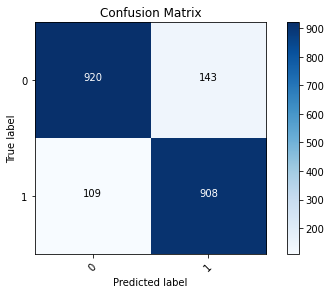

In [ ]:
plot_confusion_matrix(cm=cm,classes=[0,1] ,title='Confusion Matrix')

(3,)
(3,)


Text(0, 0.5, 'True Positive Rate')

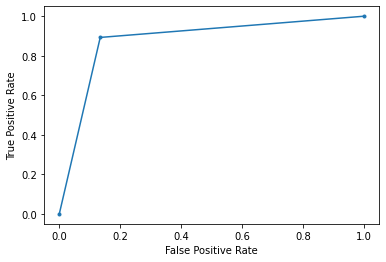

In [ ]:
from sklearn.metrics import roc_curve
#print(prediction.shape)
#prediction = prediction[:,1]
nb_fpr, nb_tpr,_= roc_curve(original,prediction)
#roc_auc = auc(lr_fpr, lr_tpr)
#print(nb_fpr)
#print(nb_tpr)
print(nb_fpr.shape)
print(nb_tpr.shape)
plt.plot(nb_fpr, nb_tpr,  marker='.', label='Naive Bayes' )

plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
# show the legend

# show the plot